# Coursework1: Convolutional Neural Networks 

## instructions

Please submit a version of this notebook containing your answers **together with your trained model** on CATe as CW2.zip. Write your answers in the cells below each question.

### Setting up working environment 

For this coursework you will need to train a large network, therefore we recommend you work with Google Colaboratory, which provides free GPU time. You will need a Google account to do so. 

Please log in to your account and go to the following page: https://colab.research.google.com. Then upload this notebook.

For GPU support, go to "Edit" -> "Notebook Settings", and select "Hardware accelerator" as "GPU".

You will need to install pytorch by running the following cell:

In [ ]:
!pip install torch torchvision

## Introduction

For this coursework you will implement one of the most commonly used model for image recognition tasks, the Residual Network. The architecture is introduced in 2015 by Kaiming He, et al. in the paper ["Deep residual learning for image recognition"](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/He_Deep_Residual_Learning_CVPR_2016_paper.pdf). 
<br>

In a residual network, each block contains some convolutional layers, plus "skip" connections, which allow the activations to by pass a layer, and then be summed up with the activations of the skipped layer. The image below illustrates a building block in residual networks.

![resnet-block](utils/resnet-block.png)

Depending on the number of building blocks, resnets can have different architectures, for example ResNet-50, ResNet-101 and etc. Here you are required to build ResNet-18 to perform classification on the CIFAR-10 dataset, therefore your network will have the following architecture:

![resnet](utils/resnet.png)

## Part 1 (40 points)

In this part, you will use basic pytorch operations to define the 2D convolution, max pooling operation, linear layer as well as 2d batch normalization. 

### YOUR TASK

- implement the forward pass for Conv2D, MaxPool2D, Linear and BatchNorm2d
- You are **NOT** allowed to use the torch.nn modules

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F


torch.manual_seed(0)

class Conv2d(nn.Module):
    def __init__(self,
                 in_channels,
                 out_channels,
                 kernel_size,
                 stride=1,
                 padding=0,
                 bias=True):

        super(Conv2d, self).__init__()
        """
        An implementation of a convolutional layer.

        The input consists of N data points, each with C channels, height H and
        width W. We convolve each input with F different filters, where each filter
        spans all C channels and has height HH and width WW.

        Parameters:
        - w: Filter weights of shape (F, C, HH, WW)
        - b: Biases, of shape (F,)
        - kernel_size: Size of the convolving kernel
        - stride: The number of pixels between adjacent receptive fields in the
            horizontal and vertical directions.
        - padding: The number of pixels that will be used to zero-pad the input.
        """

        ########################################################################
        # TODO: Define the parameters used in the forward pass                 #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        torch.manual_seed(0)
        self.C = in_channels
        self.F = out_channels
        self.kernel_size = kernel_size
        
        self.stride = stride
        self.padding = padding
        

        self.w = nn.Parameter(torch.ones(self.F, self.C, self.kernel_size, self.kernel_size))
        nn.init.xavier_uniform_(self.w)


        if bias:
          self.bias = nn.Parameter(torch.Tensor(self.F,))
          nn.init.zeros_(self.bias)
        
        else:
          self.bias = None

        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

    def forward(self, x):
        """
        Input:
        - x: Input data of shape (N, C, H, W)
        Output:
        - out: Output data, of shape (N, F, H', W').
        """

        ########################################################################
        # TODO: Implement the forward pass                                     #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

        N = x.shape[0]
        C = x.shape[1]
        H = x.shape[2]
        W = x.shape[3]

        out_H = int((H - self.kernel_size + 2*self.padding) / self.stride) + 1

        out_W = int((W - self.kernel_size + 2*self.padding) / self.stride) + 1



        # Convolution is equivalent with Unfold + Matrix Multiplication + Fold 


        unfold = F.unfold(x, self.kernel_size, dilation=1, padding= self.padding, stride = self.stride)

        unfold_trans =  unfold.transpose(1,2)

        unfold_matmul = unfold_trans @ self.w.view(self.F, -1).transpose(0,1)

        output_trans = unfold_matmul.transpose(1,2)

        if self.bias != None:
          output_trans += self.bias

        output = output_trans.view(N, self.F, out_H, out_W)

        return output

        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

        return out

    

In [ ]:
# TESTS #
torch.manual_seed(0)
input = torch.randn(1, 1, 5, 5)

conv_real = nn.Conv2d(1, 1, 3, stride= 1, bias=False)
conv_real.weight = torch.nn.Parameter(torch.ones((1, 1, 3, 3)))
conv_1 = conv_real(input)
print(conv_1)

torch.manual_seed(0)

conv = Conv2d(1, 1, 3, stride= 1, bias=False)
nn.init.ones_(conv.w)
conv_2 = conv.forward(input)
print(conv_2)

tensor([[[[-2.3918, -2.6389, -0.8890],
          [ 0.6708,  1.8483,  2.2644],
          [ 1.7742,  0.3874,  0.9557]]]], grad_fn=<ThnnConv2DBackward>)
tensor([[[[-2.3918, -2.6389, -0.8890],
          [ 0.6708,  1.8483,  2.2644],
          [ 1.7742,  0.3874,  0.9557]]]], grad_fn=<ViewBackward>)


In [ ]:
class MaxPool2d(nn.Module):
    def __init__(self, kernel_size):
        super(MaxPool2d, self).__init__()
        """
        An implementation of a max-pooling layer.

        Parameters:
        - kernel_size: the size of the window to take a max over
        """
        ########################################################################
        # TODO: Define the parameters used in the forward pass                 #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

        self.kernel_size = kernel_size

        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

    def forward(self, x):
        """
        Input:
        - x: Input data of shape (N, C, H, W)
        Output:
        - out: Output data, of shape (N, F, H', W').
        """
        ########################################################################
        # TODO: Implement the forward pass                                     #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

        # Unfold turns each box of the shape of the filter into a 
        # column of its own which we then transpose

        N = x.shape[0]
        C = x.shape[1]   # C equals output channel size (F)
        H = x.shape[2]
        W = x.shape[3]

        H_out = int(H // self.kernel_size)
        W_out = int(W // self.kernel_size)

        
        unfold_input = F.unfold(x, self.kernel_size, stride=self.kernel_size).transpose(2,1)
        
        unfold_input = unfold_input.view(N, -1, C, self.kernel_size**2).transpose(2,1)
        
        out = torch.max(unfold_input, 3)[0].view(N, C, H_out, W_out)
        
        return out

        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

        return out

In [ ]:
# TESTS #
torch.manual_seed(10)
max_me = MaxPool2d(2)
max_real = nn.MaxPool2d(2)

# Tried with three different inputs to make sure they work
#input1 = torch.Tensor([[[[6,1,2,4,7,8],[1,6,7,8,9,3], [3,5,2,0,2,5], [1,2,3,4,3,5],[6,1,2,4,8,7],[1,6,7,8,1,2]]]])
#input2 = torch.Tensor([[[[6,1,2,4,7],[1,6,7,8,9], [3,5,2,0,2], [1,2,3,4,3],[6,1,2,4,8]]]])
input3 = torch.randn(1, 2, 6, 6)

ans_me = max_me.forward(input3)
print(ans_me)
ans_real = max_real.forward(input3)
print(ans_real)

tensor([[[[ 2.6278,  1.0051,  0.4765],
          [ 1.1167,  1.0763,  1.1209],
          [ 0.2456,  1.3290,  0.2121]],

         [[ 0.9741,  0.1490, -0.8832],
          [-0.4811,  2.7470,  1.3373],
          [ 0.0948,  1.2828,  1.3399]]]])
tensor([[[[ 2.6278,  1.0051,  0.4765],
          [ 1.1167,  1.0763,  1.1209],
          [ 0.2456,  1.3290,  0.2121]],

         [[ 0.9741,  0.1490, -0.8832],
          [-0.4811,  2.7470,  1.3373],
          [ 0.0948,  1.2828,  1.3399]]]])


In [ ]:
class Linear(nn.Module):
    def __init__(self, in_channels, out_channels, bias=True):
        super(Linear, self).__init__()
        """
        An implementation of a Linear layer.

        Parameters:
        - weight: the learnable weights of the module of shape (in_channels, out_channels).
        - bias: the learnable bias of the module of shape (out_channels).
        """
        ########################################################################
        # TODO: Define the parameters used in the forward pass                 #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

        self.in_channels = in_channels
        self.out_channels = out_channels
        

        self.w = nn.Parameter(torch.ones(self.in_channels, self.out_channels))
        torch.nn.init.xavier_uniform_(self.w)

        if bias:
          self.bias = nn.Parameter(torch.zeros(self.out_channels,))
          torch.nn.init.zeros_(self.bias)

        else:
          self.bias = None



        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

    def forward(self, x):
        """
        Input:
        - x: Input data of shape (N, *, H) where * means any number of additional
        dimensions and H = in_channels
        Output:
        - out: Output data of shape (N, *, H') where * means any number of additional
        dimensions and H' = out_channels
        """
        ########################################################################
        # TODO: Implement the forward pass                                     #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

        N = x.shape[0]
        H = x.shape[-1]

        output = x @ self.w

        if self.bias != None:
          output += self.bias

        return output

        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

        return out

In [ ]:
# TESTS #
torch.manual_seed(10)
input = torch.Tensor([3, 5, 4])

linear = Linear(3, 4, bias=False)
nn.init.ones_(linear.w)
linear_me = linear.forward(input)
print(linear_me)

linear_torch = nn.Linear(3, 4, bias=False)
# the 4 and the 3 are the other way around here as 
# pytorch module defines weight as 
# self.weight = Parameter(torch.Tensor(out_features, in_features))
linear_torch.weight = nn.Parameter(torch.ones(4, 3))
linear_t = linear_torch.forward(input)
print(linear_t)

tensor([12., 12., 12., 12.], grad_fn=<SqueezeBackward3>)
tensor([12., 12., 12., 12.], grad_fn=<SqueezeBackward3>)


In [ ]:
class BatchNorm2d(nn.Module):
    def __init__(self, num_features, eps=1e-05, momentum=0.1, training= True):
        super(BatchNorm2d, self).__init__()
        """
        An implementation of a Batch Normalization over a mini-batch of 2D inputs.

        The mean and standard-deviation are calculated per-dimension over the
        mini-batches and gamma and beta are learnable parameter vectors of
        size num_features.

        Parameters:
        - num_features: C from an expected input of size (N, C, H, W).
        - eps: a value added to the denominator for numerical stability. Default: 1e-5
        - momentum: momentum – the value used for the running_mean and running_var
        computation. Default: 0.1
        - gamma: the learnable weights of shape (num_features).
        - beta: the learnable bias of the module of shape (num_features).
        """
        ########################################################################
        # TODO: Define the parameters used in the forward pass                 #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        torch.manual_seed(10)
        self.num_features = num_features
        self.eps = eps
        self.momentum = momentum

        self.gamma = nn.Parameter(torch.ones(1, self.num_features, 1, 1))
        
        self.beta = nn.Parameter(torch.zeros(1, self.num_features, 1, 1))

        self.moving_mean = torch.zeros(1, self.num_features, 1, 1)
        self.moving_std = torch.ones(1, self.num_features, 1, 1)

        self.training = training


        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

    def forward(self, x):
        """
        During training this layer keeps running estimates of its computed mean and
        variance, which are then used for normalization during evaluation.
        Input:
        - x: Input data of shape (N, C, H, W)
        Output:
        - out: Output data of shape (N, C, H, W) (same shape as input)
        """
        ########################################################################
        # TODO: Implement the forward pass                                     #
        #       (be aware of the difference for training and testing)          #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        torch.manual_seed(10)
        if not self.training:
            
          x_hat = (x - self.moving_mean) / torch.sqrt(self.moving_std + self.eps)
        
        else:

          
          mu = x.mean(dim=(0,2,3), keepdim=True)
          sigma = x.std(dim=(0,2,3), keepdim=True)
          var = sigma**2

          x_hat = (x - mu) / torch.sqrt(var + self.eps)
          
          self.moving_mean = self.momentum * self.moving_mean + (1.0 - self.momentum) * mu
          self.moving_std = self.momentum * self.moving_std + (1.0 - self.momentum) * var
      # check as in other version they did it with var in line above

        Y = self.gamma * x_hat + self.beta

        return Y
        


        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

        

In [ ]:
"""
This is extra from the BatchNorm tutorial, used as an additional check 
for my coursework implementation from the cell above

"""

class BatchNorm(nn.Module):
    def __init__(self, shape, eps=1e-5, momentum=0.1):
        """
        shape: Expected shape of input
        eps: epsilon used in normalization step
        momentum: momentum value used to update moving averages
        """
        super().__init__()
        if len(shape) not in (2, 4):
            raise ValueError("Invalid input shape!")

        self.eps = eps
        self.momentum = momentum

        # PART 1: defining Pytorch learnable parameters (hint: use `shape` argument
        # which should depend on whether the input is from FC or Conv). NOTE:
        # tests expect that broadcasting will be used in PART 8 below, so define
        # your parameters accordingly.
        # UPDATE:
        if len(shape) == 2:

          self.gamma = nn.Parameter(torch.zeros(1, shape[1]))
          nn.init.uniform_(self.gamma, 0, 1)
          
          self.beta = nn.Parameter(torch.zeros(1, shape[1]))
          nn.init.uniform_(self.beta, 0, 1)
        
        if len(shape) == 4:

          self.gamma = nn.Parameter(torch.ones(1, shape[1], 1, 1))
          #nn.init.uniform_(self.gamma, 0, 1)
          
          self.beta = nn.Parameter(torch.zeros(1, shape[1], 1, 1))
          #nn.init.uniform_(self.beta, 0, 1)

        # PART 2: initialize moving avg variables (hint: these are NOT learnable 
        # parameters)
        # UPDATE:
        if len(shape) == 2:
          self.moving_mu = torch.zeros(1, shape[1])
          self.moving_sigma = torch.ones(1, shape[1])

        if len(shape) == 4:
          self.moving_mu = torch.zeros(1, shape[1], 1, 1)
          self.moving_sigma = torch.ones(1, shape[1], 1, 1)


    def forward(self, x):
        # Test
        if not torch.is_grad_enabled():
            # PART 3: Test time normalization operation; use self.eps as epsilon
            # UPDATE:
            x_hat = (x - self.moving_mu) / torch.sqrt(self.moving_sigma + self.eps)

            # Logging code for tests; ignore:
            self._tmp_x_hat_test = x_hat
        
        # Training
        else:
            if len(x.shape) == 2:
                # PART 4: Compute mean and var for FC input (retaining feature dim)
                # UPDATE:
                mean = x.mean(dim=(0), keepdim=True)
                std = x.std(dim=(0), keepdim=True)
                var = std**2

            elif len(x.shape) == 4:
                # PART 5: Compute mean and var for Conv input (retaining channel dim)
                # UPDATE (hint: use `keepdim` flag to use broadcasting later):
                mean = x.mean(dim=(0,2,3), keepdim=True)
                std = x.std(dim=(0,2,3), keepdim=True)
                var = std**2
            else:
                raise ValueError("Incorrect input shape!")
            
            # Logging code for tests; ignore:
            self._tmp_mean = mean
            self._tmp_var = var

            # PART 6: Training time normalization operation; use self.eps as epsilon
            # UPDATE:
            x_hat = (x - mean) / torch.sqrt(var + self.eps)

            # Logging code for tests; ignore:
            self._tmp_x_hat_train = x_hat
            
            # PART 7: Updating moving averages; use self.momentum to calculate
            # contribution to update (hint: be careful about unnecessary 
            # autograd computation tracking)
            # UPDATE:
            self.moving_mu = self.momentum * self.moving_mu + (1 - self.momentum)*mean
            self.moving_sigma = self.momentum * self.moving_sigma + (1 - self.momentum)*var

            # Logging code for tests; ignore:
            self._tmp_moving_mu = self.moving_mu
            self._tmp_moving_sigma = self.moving_sigma

        # PART 8: Scale and shift x_hat using learnable parameters to compute output
        # UPDATE:
        z = x_hat * self.gamma + self.beta
      
        return z

In [ ]:
# TESTS #
torch.manual_seed(10)

input = torch.randn(1, 2, 4, 4)
bn = BatchNorm2d(2, training=True)
print(bn.forward(input))

b = BatchNorm((1, 2, 4, 4))
print(b.forward(input))


tensor([[[[-0.5240, -0.2591, -0.5335, -1.0094],
          [ 0.1034, -0.6728, -0.2163,  2.9627],
          [-0.4523,  1.3204,  0.0433,  0.7854],
          [-0.3700, -0.0638, -1.1647,  0.0506]],

         [[ 0.8100,  1.3459,  1.1231,  1.3381],
          [ 1.2637, -0.8392, -0.4752, -0.4079],
          [-0.6139, -0.2653,  1.0377, -0.0633],
          [-0.3269, -1.3390, -1.3681, -1.2196]]]], grad_fn=<AddBackward0>)
tensor([[[[-0.5240, -0.2591, -0.5335, -1.0094],
          [ 0.1034, -0.6728, -0.2163,  2.9627],
          [-0.4523,  1.3204,  0.0433,  0.7854],
          [-0.3700, -0.0638, -1.1647,  0.0506]],

         [[ 0.8100,  1.3459,  1.1231,  1.3381],
          [ 1.2637, -0.8392, -0.4752, -0.4079],
          [-0.6139, -0.2653,  1.0377, -0.0633],
          [-0.3269, -1.3390, -1.3681, -1.2196]]]], grad_fn=<AddBackward0>)


## Part 2

In this part, you will train a ResNet-18 defined on the CIFAR-10 dataset. Code for training and evaluation are provided. 

### Your Task

1. Train your network to achieve the best possible test set accuracy after a maximum of 10 epochs of training.

2. You can use techniques such as optimal hyper-parameter searching, data pre-processing

3. If necessary, you can also use another optimizer

4. **Answer the following question:**
Given such a network with a large number of trainable parameters, and a training set of a large number of data, what do you think is the best strategy for hyperparameter searching? 

**Q: Given such a network with a large number of trainable parameters, and a training set of a large number of data, what do you think is the best strategy for hyperparameter searching?**

Deep learning models have countless trainable parameters and finding the optimal configuration is not a trivial challenge. There are several potential strategies, Trial and Error, Grid Search and Random Search. Trial and Error is fairly self explanatory, but not particularly effective with such a large number of parameters and a large dataset. With Grid search we just try every possible configuration, but this is a very naive approach and is very not efficient. Random search on the other hand is more effective than Grid search when dealing with a vast number of hyperparameters and a large dataset, and it generally gives better overall results after a lower number of iterations. 

The best strategy for hyperparameter searching overall is Bayesian Optimization. This search strategy builds a probability (surrogate) model of the objective function and uses it to select hyperparameter to evaluate in the true objective function. Essentially it tries to predict the metrics we care about from the hyperparameters configuration. As we move through the iterations the probability model becomes more and more confident about which guess leads to improvements. We use the Gaussian process as the probability model that will learn the mapping from hyperparameters configuration to the metric of interest. 



In [ ]:
import torch
from torch.nn import Conv2d, MaxPool2d
import torch.nn as nn
import torch.nn.functional as F

from itertools import product


Next, we define ResNet-18:

In [ ]:
# define resnet building blocks

class ResidualBlock(nn.Module): 
    def __init__(self, inchannel, outchannel, stride=1): 
        
        super(ResidualBlock, self).__init__() 
        
        self.left = nn.Sequential(Conv2d(inchannel, outchannel, kernel_size=3, 
                                         stride=stride, padding=1, bias=False), 
                                  nn.BatchNorm2d(outchannel), 
                                  nn.ReLU(inplace=True), 
                                  Conv2d(outchannel, outchannel, kernel_size=3, 
                                         stride=1, padding=1, bias=False), 
                                  nn.BatchNorm2d(outchannel)) 
        
        self.shortcut = nn.Sequential() 
        
        if stride != 1 or inchannel != outchannel: 
            
            self.shortcut = nn.Sequential(Conv2d(inchannel, outchannel, 
                                                 kernel_size=1, stride=stride, 
                                                 padding = 0, bias=False), 
                                          nn.BatchNorm2d(outchannel) ) 
            
    def forward(self, x): 
        
        out = self.left(x) 
        
        out += self.shortcut(x) 
        
        out = F.relu(out) 
        
        return out


    
    # define resnet

class ResNet(nn.Module):
    
    def __init__(self, ResidualBlock, num_classes = 10):
        
        super(ResNet, self).__init__()
        
        self.inchannel = 64
        self.conv1 = nn.Sequential(Conv2d(3, 64, kernel_size = 3, stride = 1,
                                            padding = 1, bias = False), 
                                  nn.BatchNorm2d(64), 
                                  nn.ReLU())
        
        self.layer1 = self.make_layer(ResidualBlock, 64, 2, stride = 1)
        self.layer2 = self.make_layer(ResidualBlock, 128, 2, stride = 2)
        self.layer3 = self.make_layer(ResidualBlock, 256, 2, stride = 2)
        self.layer4 = self.make_layer(ResidualBlock, 512, 2, stride = 2)
        self.maxpool = MaxPool2d(4)
        self.fc = nn.Linear(512, num_classes)
        
    
    def make_layer(self, block, channels, num_blocks, stride):
        
        strides = [stride] + [1] * (num_blocks - 1)
        
        layers = []
        
        for stride in strides:
            
            layers.append(block(self.inchannel, channels, stride))
            
            self.inchannel = channels
            
        return nn.Sequential(*layers)
    
    
    def forward(self, x):
        
        x = self.conv1(x)
        
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        
        x = self.maxpool(x)
        
        x = x.view(x.size(0), -1)
        
        x = self.fc(x)
        
        return x
    
    
def ResNet18():
    return ResNet(ResidualBlock)

### Loading dataset
We will import images from the [torchvision.datasets](https://pytorch.org/docs/stable/torchvision/datasets.html) library <br>
First, we need to define the alterations (transforms) we want to perform to our images - given that transformations are applied when importing the data. <br>
Define the following transforms using the torchvision.datasets library -- you can read the transforms documentation [here](https://pytorch.org/docs/stable/torchvision/transforms.html): <br>
1. Convert images to tensor
2. Normalize mean and std of images with values:mean=[0.4914, 0.4822, 0.4465], std=[0.2023, 0.1994, 0.2010]

In [ ]:
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler


import torchvision.datasets as dset

import numpy as np

import torchvision.transforms as T

import torchvision
import matplotlib.pyplot as plt



torch.set_printoptions(linewidth=120)
torch.set_grad_enabled(True)
from torch.utils.tensorboard import SummaryWriter

##############################################################
#                       YOUR CODE HERE                       #       
##############################################################

transform_normalise = T.Compose([T.ToTensor(),
                                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
                                T.RandomHorizontalFlip(),
                                T.RandomResizedCrop(32)])
                               
                               #T.ColorJitter(saturation=0.01, hue=0.01)

"""ColorJitter, RandomHorizontal Flip and RandomResizedCrop were added
to increase the robustenss of the training through data augmentation. Tried all three 
and found that the ColorJitter poorly affected our accuracy after 10 
iterations and therefore left this one out in the final implementation """


##############################################################
#                       END OF YOUR CODE                     #
##############################################################




'added ColorJitter, RandomHorizontal Flip and RandomResizedCrop to increase the robustenss\nof the training. Tried all three and found that the ColorJitter poorly affected our \naccuracy after 10 iterations and therefore left this one out in the final implementation '

Now load the dataset using the transform you defined above, with batch_size = 64<br>
You can check the documentation [here](https://pytorch.org/docs/stable/torchvision/datasets.html).
Then create data loaders (using DataLoader from torch.utils.data) for the training and test set

Files already downloaded and verified
Files already downloaded and verified


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5000
704
torch.Size([64, 3, 32, 32])
labels tensor([4, 0, 1, 8, 8, 5, 4, 4, 0, 7, 9, 6, 2, 6, 9, 0, 3, 2, 1, 8, 0, 7, 1, 3, 9, 5, 6, 6, 1, 4, 1, 1, 6, 4, 5, 5, 4,
        3, 6, 5, 5, 5, 6, 8, 5, 5, 6, 7, 9, 0, 2, 2, 7, 4, 3, 2, 1, 8, 5, 4, 7, 6, 9, 9])


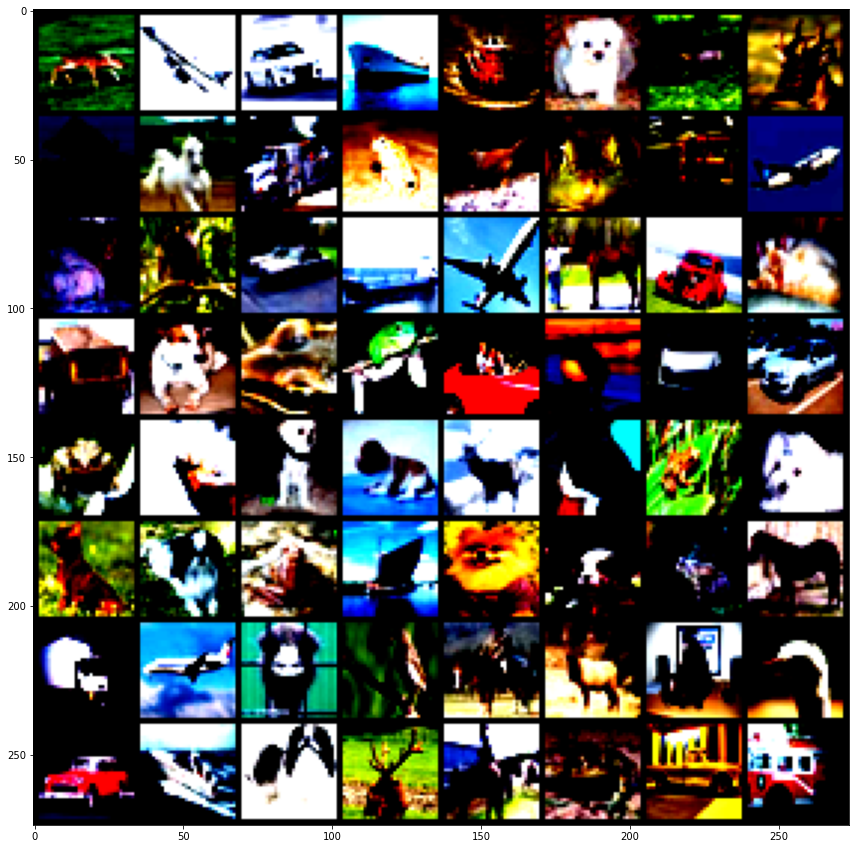

In [ ]:

##############################################################
#                       YOUR CODE HERE                       #       
##############################################################

val_percent = 0.1

batch_size = 64

data_dir = './data'

trainval_data = dset.CIFAR10(
    root = data_dir,
    train = True,
    download= True,
    transform = transform_normalise
)

test_data = dset.CIFAR10(
    root = data_dir,
    train = False,
    download= True,
    transform = transform_normalise
)



trainval_length = len(trainval_data)

val_split_num = int(np.floor(val_percent * trainval_length))

print(val_split_num)


loader_val = DataLoader(trainval_data, batch_size= batch_size, 
                        sampler= sampler.SubsetRandomSampler(range(val_split_num)))

loader_train = DataLoader(trainval_data, batch_size= batch_size, 
                          sampler= sampler.SubsetRandomSampler(range(val_split_num, trainval_length)))

print(len(loader_train))

loader_test = DataLoader(test_data)



batch = next(iter(loader_train))
len(batch)
images, labels = batch

print(images.shape)


grid = torchvision.utils.make_grid(images)
plt.figure(figsize=(15,15))
plt.imshow(np.transpose(grid, (1,2,0)))

print('labels', labels)

##############################################################
#                       END OF YOUR CODE                     #       
##############################################################



In [ ]:
USE_GPU = True
dtype = torch.float32 

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')
    
    

print_every = 100
def check_accuracy(loader, model):
    # function for test accuracy on validation and test set
    
    if loader.dataset.train:
        print('Checking accuracy on validation set')
    else:
        print('Checking accuracy on test set')   
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
        acc = float(num_correct) / num_samples
        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
    
    return acc
        

def train_part(model, optimizer, epochs=1):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    for e in range(epochs):
        print(len(loader_train))
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = F.cross_entropy(scores, y)

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            loss.backward()

            # Update the parameters of the model using the gradients
            optimizer.step()

            if t % print_every == 0:
                print('Epoch: %d, Iteration %d, loss = %.4f' % (e, t, loss.item()))
                acc = check_accuracy(loader_val, model)
                writer.add_scalar('accuracy', acc, e)

                # added this to add variables to tensorboard to see the impact of
                # changing parameters
                for name, weight in model.named_parameters():
                  writer.add_histogram(name, weight, e)
                  writer.add_histogram(f'{name}.grad', weight.grad, e)
                #writer.add_histogram('conv1.weight', model.conv1[0].weight, e)
                print()

In [ ]:
# code for optimising your network performance

##############################################################
#                       YOUR CODE HERE                       #       
##############################################################
"""
Learning rate is an optimization parameter that tends to minimise 
the loss function thereby reduces the model's error. The adam optimizer
was intially analysed for a few different learning rates of 0.01, 0.005, 
0.001 and 0.0005 to get some ideas of good values for the learning 
rate parameter. Following these results it was found that learning rates 
around 0.001 were good and therefore a larger experiment was run with 
many more values focussed around this area to pin point the best 
learning rate.
(graphs are plotted below in Tensorboard for the accuracies of different 
learning rates)

"""
torch.manual_seed(10)

#parameters = dict(
#    lr = [0.005, 0.002, 0.0015, 0.001, 0.0005, 0.0001, 0.00005, 0.00001, 0.000005])

#param_values = [v for v in parameters.values()]

#for lr in product(*param_values):
#  comment = f'lr={lr}'

# writer is used to send data to tensorboard
writer = SummaryWriter()

##############################################################
#                       END OF YOUR CODE                     #
##############################################################
torch.manual_seed(4)

# define and train the network
model = ResNet18()
optimizer = optim.Adam(model.parameters(), lr= 0.001)

train_part(model, optimizer, epochs = 10)

# report test set accuracy

check_accuracy(loader_test, model)

writer.close()
# save the model
torch.save(model.state_dict(), 'model2.pt')

704
Epoch: 0, Iteration 0, loss = 2.8786
Checking accuracy on validation set
Got 472 / 5000 correct (9.44)

Epoch: 0, Iteration 100, loss = 1.9019
Checking accuracy on validation set
Got 1862 / 5000 correct (37.24)

Epoch: 0, Iteration 200, loss = 1.3645
Checking accuracy on validation set
Got 2299 / 5000 correct (45.98)

Epoch: 0, Iteration 300, loss = 1.4722
Checking accuracy on validation set
Got 2599 / 5000 correct (51.98)

Epoch: 0, Iteration 400, loss = 1.8368
Checking accuracy on validation set
Got 2524 / 5000 correct (50.48)

Epoch: 0, Iteration 500, loss = 1.1582
Checking accuracy on validation set
Got 2958 / 5000 correct (59.16)

Epoch: 0, Iteration 600, loss = 1.1245
Checking accuracy on validation set
Got 3009 / 5000 correct (60.18)

Epoch: 0, Iteration 700, loss = 0.9882
Checking accuracy on validation set
Got 2779 / 5000 correct (55.58)

704
Epoch: 1, Iteration 0, loss = 1.2259
Checking accuracy on validation set
Got 2501 / 5000 correct (50.02)

Epoch: 1, Iteration 100, l

In [ ]:

grid = torchvision.utils.make_grid(images)
               
images, labels = images.cuda(), labels.cuda()

#writer.add_image(tag= 'images', img_tensor= grid)
#writer.add_graph(model, images)
#writer.close()

In [ ]:
# used tensorboard to visualise the results 

#%load_ext tensorboard
%reload_ext tensorboard
%tensorboard --logdir=runs


Output hidden; open in https://colab.research.google.com to view.

## Part 3

The code provided below will allow you to visualise the feature maps computed by different layers of your network. Run the code (install matplotlib if necessary) and **answer the following questions**: 

1. Compare the feature maps from low-level layers to high-level layers, what do you observe? 

2. Use the training log, reported test set accuracy and the feature maps, analyse the performance of your network. If you think the performance is sufficiently good, explain why; if not, what might be the problem and how can you improve the performance?

3. What are the other possible ways to analyse the performance of your network?

**YOUR ANSWER FOR PART 3 HERE**

A: 
**Q1: Compare the feature maps from low-level layers to high-level layers, what do you observe?**



Visualizing how a CNN learns to identify different features present in images provides a deeper insight into how the model works. It will also help to understand why the model might be failing to classify some of the images correctly and hence fine-tuning the model for better accuracy and precision. These methods aim at learning high-level semantic features via a hierarchical architecture to predict image categories.

We can see that the feature maps closer to the input of the model capture a lot of fine detail in the image, ie: edges and blobs. For the example image we have below of a truck, we can clearly see that after the convolutional layer distinctive and discriminative features such as the edges and corners of the truck light up in different feature maps. Therefore we have detected multiple features in this single convolutional layer. The next layer combines previous features to extract more complex representations as it learns features of features of the first layer. When we progress deeper into the model, the feature maps show less and less detail and the model learns higher level features as we have lower spatial resolution.

This pattern is expected, as the model abstracts the features from the image into more general concepts that can be used to make a classification. We generally lose the ability to interpret these deeper feature maps.




**Q2: Use the training log, reported test set accuracy and the feature maps, analyse the performance of your network. If you think the performance is sufficiently good, explain why; if not, what might be the problem and how can you improve the performance?**



Considering the number of epochs is only 10, I believe this training is to a high level. The training log shows that the accuracy on the validation sets increased sequentially from epoch to epoch showing the system was learning. In addition, the test accuracy of 83.39% is a very good result and it reveals a good performance of the network. 

The low-level layers of the feature maps, as seen below, extract hierachical, discrimitive and distinctive features. These inlude but are not limited to edges and corners of the truck. As we move into deeper feature maps, such as layers 3 and 4, we can see that nearly all of the light ups in the feature maps are associated with the truck, showing that our network is recognising many different higher level features associated with the truck. 

Even though the overall performance is good, even relative to the state of the art system only a few years ago, there are still places in the network where improvements could be implemented to increase the overall performance. The first beneficial  experiment would be to vary the train / validation / test split to find the optimal split. We could introduce drop out and could vary the batchsize to see if either have a positive impact on our accuracy. There is a strong potential for success by trying out different optimizers such as adagrad, Rmsprop, adam adaddelta, adamax and nadam. Finally another potential improvement would be to vary the number of layers in the ResNet, ie: make ResNet-50.





**Q3: What are the other possible ways to analyse the performance of your network?** 

Accuracy is a good measure to use here, but there are a variety of other evaluation metrics that we could use to analyse the performance of the network. Drawing out the entire confusion matrix for our data is a very good way to analyse how our data is spread out between true positives, false positives, false negatives and true negatives, and to see if we have a balanced data distribution. From the confusion matrix we can calculate the F1 score (the harmonic mean of precision and recall) and we can look at the metrics recall, precision and macro-averaged recall. 

We can look at robustenss of the model in terms of the degradation in performance with respect to varying noise levels or other image artefacts. 

On top of accuracy measures we want our models to be fast to train and to query, so we can look at the rate of convergence. We can analyse how scalable it is so that it will work well with large datasets, and how interpretable it is so that it is understandable and the model can explain its predictions.


.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


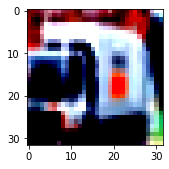

In [ ]:
torch.manual_seed(11)

data, _ = test_data[11]
data = data.unsqueeze_(0)

grid = torchvision.utils.make_grid(data)
plt.figure(figsize=(2.5,2.5))
plt.imshow(np.transpose(grid, (1,2,0)))


<Figure size 432x288 with 0 Axes>

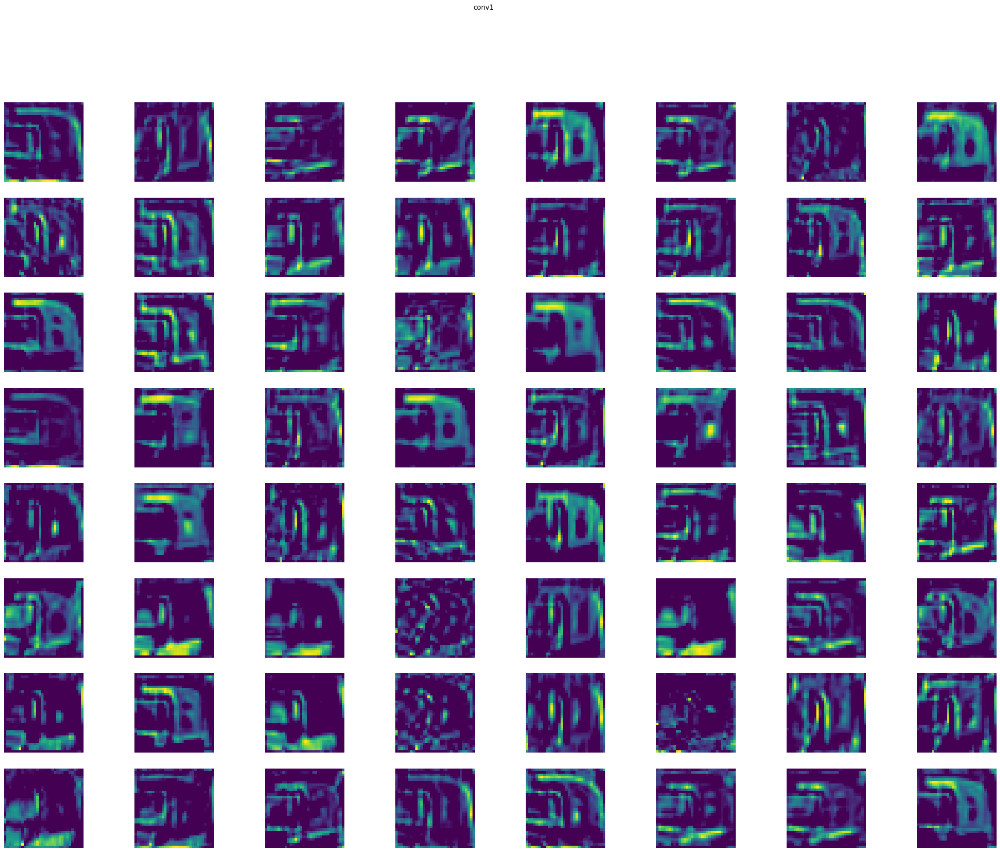

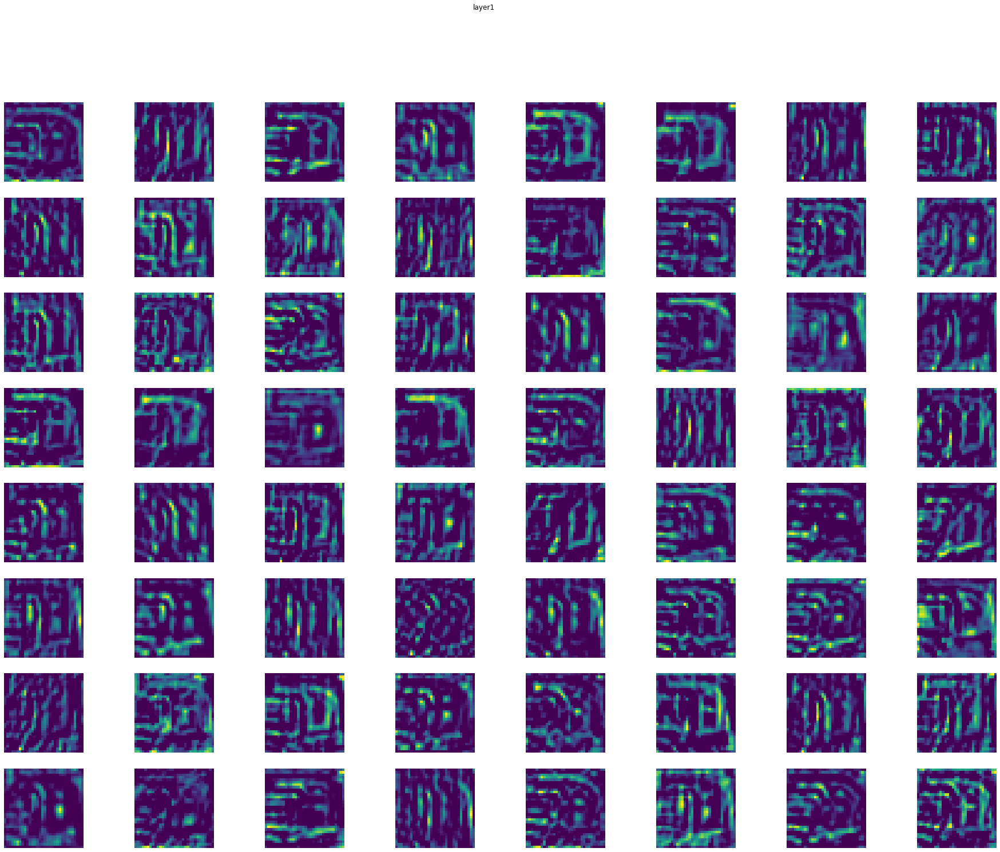

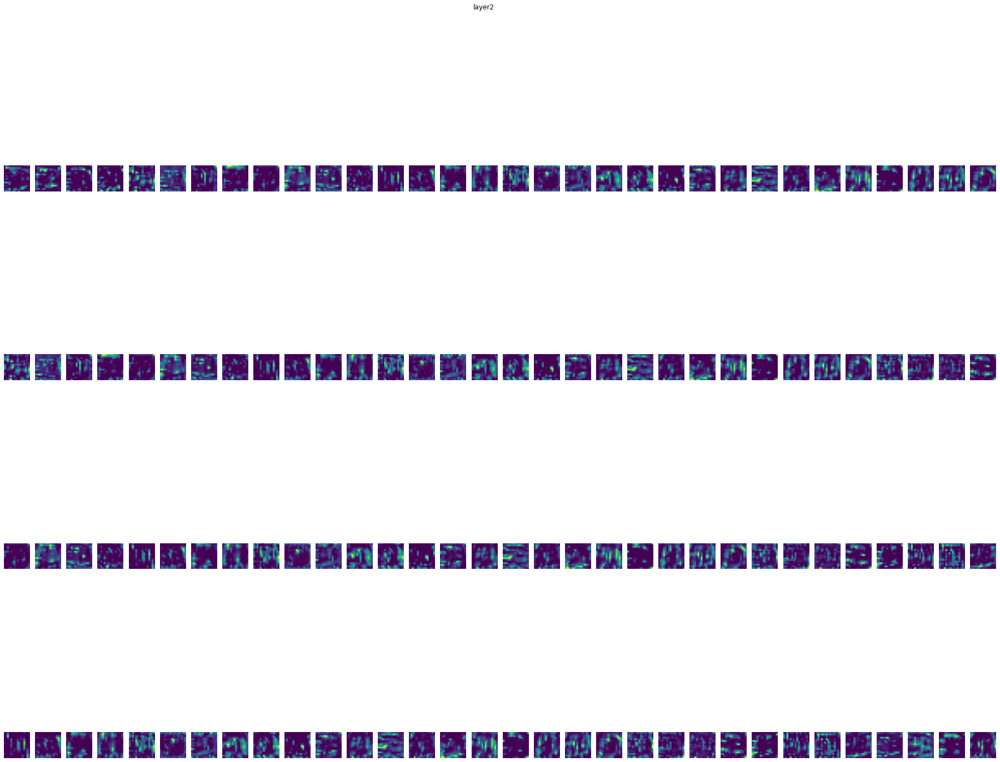

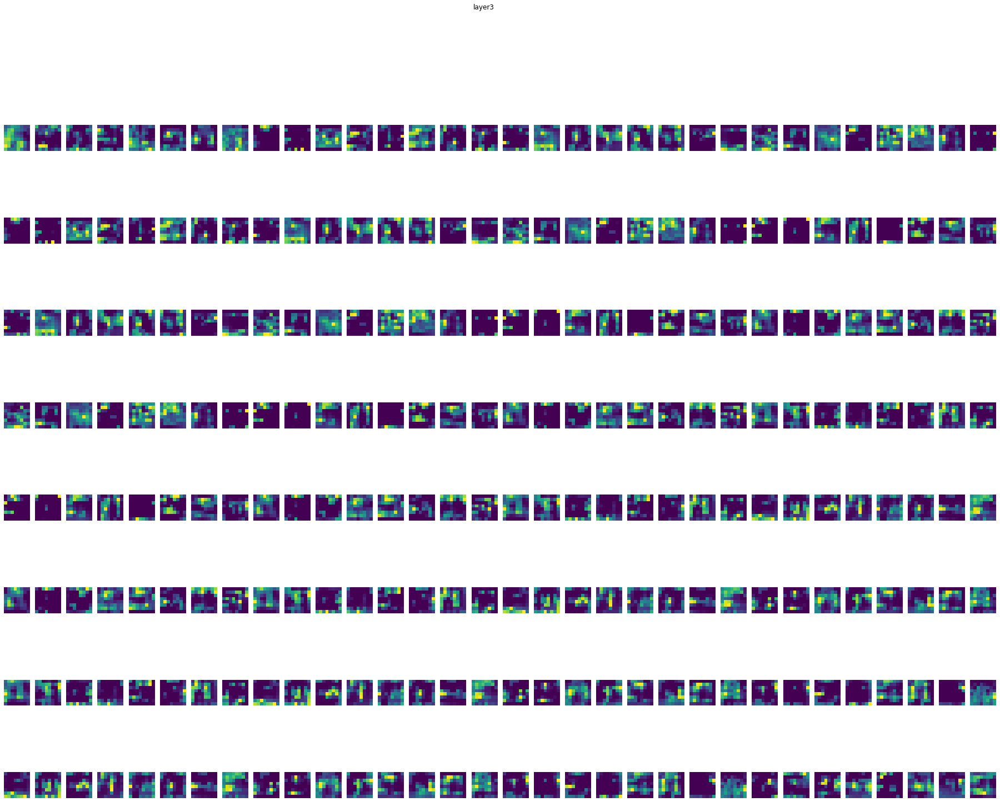

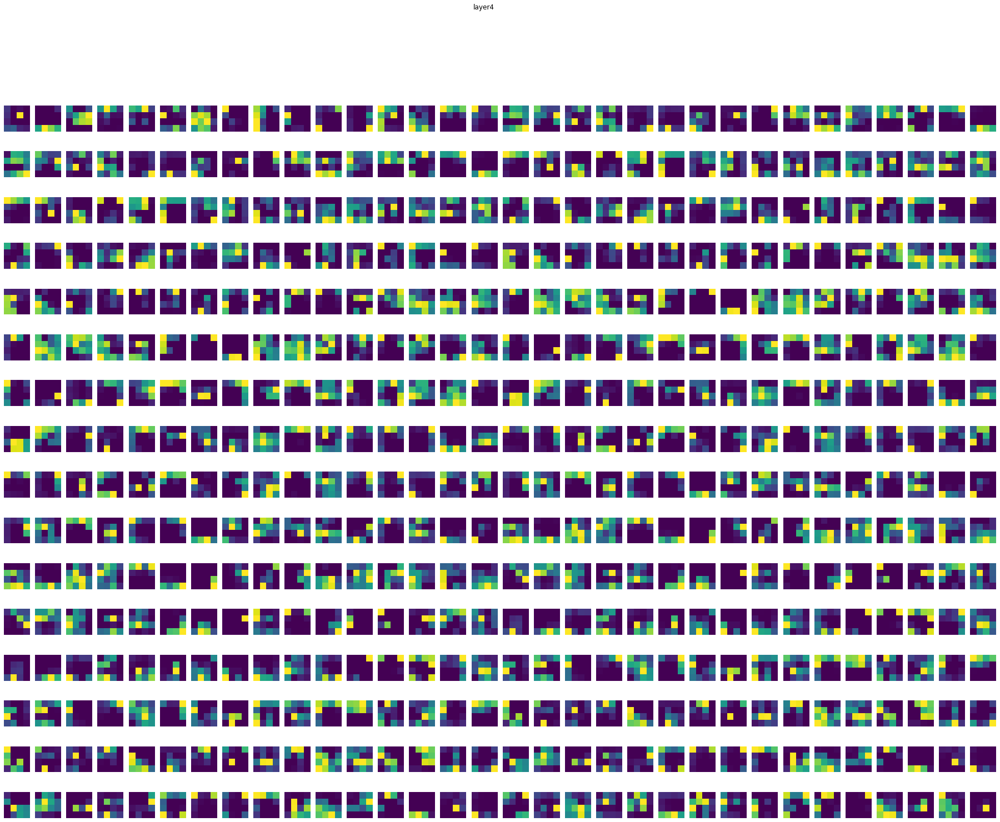

In [ ]:
#!pip install matplotlib

torch.manual_seed(11)

import matplotlib.pyplot as plt

plt.tight_layout()


activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

vis_labels = ['conv1', 'layer1', 'layer2', 'layer3', 'layer4']

for l in vis_labels:

    getattr(model, l).register_forward_hook(get_activation(l))
    
    
data, _ = test_data[11]
data = data.unsqueeze_(0).to(device = device, dtype = dtype)

output = model(data)



for idx, l in enumerate(vis_labels):

    act = activation[l].squeeze()

    if idx < 2:
        ncols = 8
    else:
        ncols = 32
        
    nrows = act.size(0) // ncols
    
    fig, axarr = plt.subplots(nrows, ncols, figsize= (32,24))
    fig.suptitle(l)


    for i in range(nrows):
        for j in range(ncols):
            axarr[i, j].imshow(act[i * nrows + j].cpu())
            axarr[i, j].axis('off')